# Lecture 0: Dynamical models

In [26]:
import numpy as np
import networkx as nx

In [4]:
import matplotlib
from matplotlib import cm
import matplotlib.pyplot as plt
%matplotlib inline

**New modules!** [tqdm](https://github.com/tqdm/tqdm) permits to check nicely how fast is your loop running:

In [342]:
from tqdm import notebook

In [133]:
import networkx as nx

Actually, networkx is for kidz... [igraph](https://igraph.org/python/) here is able to handle more or less everything!

In [6]:
import igraph as ig

[Cairocffi](https://cairocffi.readthedocs.io/en/stable/) is needed in order to plot with igraph (we won't do it during the lecture, but you better know it)

In [7]:
import cairocffi

## Basic properties of Hep-th network
Hep-th is the categories in arXiv devoted to theoretical (th) papers in High Energy Physics (HEP). The present network represents the co-authorship of various scholars:
![](../Images/hep_th_net.png)

### Loading data

In [48]:
data=np.genfromtxt('../Data/ca-HepTh.txt', skip_header=2, dtype='i8')-1

In [49]:
len(data)

51971

In [50]:
vertices=np.unique(data)

In [39]:
lv=len(vertices)

In [38]:
le=len(data)

### networkx

In [134]:
hep_th_nx=nx.Graph()
hep_th_nx.add_edges_from(data)

In [149]:
nx.draw(hep_th_nx)

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7efc82cd21e0> (for post_execute):


KeyboardInterrupt: 

#### Degree sequence

In [175]:
hep_th_nx.degree()

DegreeView({0: 3, 49153: 2, 10923: 1, 32772: 7, 49160: 2, 32779: 2, 49164: 8, 49165: 2, 15: 9, 65552: 23, 49171: 7, 49172: 2, 49173: 2, 58376: 1, 49175: 2, 49176: 2, 65561: 11, 16410: 17, 49180: 6, 16413: 6, 16414: 2, 32799: 18, 65569: 4, 65570: 1, 32803: 1, 49189: 4, 38: 2, 16423: 1, 33934: 3, 16426: 3, 43: 1, 44: 1, 32813: 12, 32814: 2, 32816: 1, 65585: 8, 16434: 3, 43699: 9, 5471: 2, 65596: 2, 65598: 1, 32831: 10, 32832: 31, 32833: 1, 16450: 6, 49219: 2, 16452: 2, 32837: 7, 16454: 8, 54625: 1, 49224: 6, 65614: 3, 19095: 2, 65616: 4, 65617: 3, 65618: 2, 16467: 1, 65620: 5, 65621: 1, 65623: 3, 65624: 3, 65625: 2, 65626: 6, 32859: 3, 16476: 1, 32862: 1, 32863: 2, 96: 30, 65633: 3, 16482: 4, 49253: 15, 51900: 6, 59470: 38, 65646: 2, 16495: 23, 32880: 12, 65649: 3, 65650: 1, 115: 14, 10942: 7, 62825: 2, 27327: 4, 65660: 4, 65661: 2, 4: 2, 16511: 2, 128: 1, 31851: 4, 131: 2, 135: 7, 16520: 11, 16521: 3, 139: 3, 27330: 6, 49294: 36, 38253: 2, 32912: 1, 49298: 12, 32915: 1, 49300: 1, 8358: 

In [176]:
hep_th_k=np.array(hep_th_nx.degree())

In [177]:
hep_th_kk=np.unique(hep_th_k[:,1], return_counts=True)

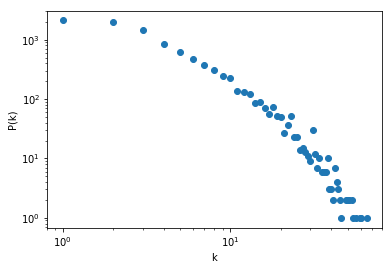

In [178]:
plt.scatter(hep_th_kk[0], hep_th_kk[1])
plt.xlabel('k')
plt.ylabel('P(k)')
plt.xscale('log')
plt.yscale('log')
plt.show()

#### Clustering coefficient

In [48]:
hep_th_clust=nx.average_clustering(hep_th_nx)

In [49]:
print(hep_th_clust)

0.47143905296693306


In [160]:
%timeit nx.average_clustering(hep_th_nx)

456 ms ± 336 µs per loop (mean ± std. dev. of 7 runs, 1 loop each)


#### Average path length

In [151]:
nx.average_shortest_path_length(hep_th_nx)

NetworkXError: Graph is not connected.

In [157]:
hep_th_nx_lcc=max(nx.connected_components(hep_th_nx), key=len)
hep_th_nx_lcc=hep_th_nx.subgraph(hep_th_nx_lcc).copy()

In [158]:
print(hep_th_nx.number_of_nodes())
print(hep_th_nx_lcc.number_of_nodes())

9877
8638


In [159]:
nx.average_shortest_path_length(hep_th_nx_lcc)

KeyboardInterrupt: 

In [ ]:
%timeit nx.average_shortest_path_length(hep_th_nx_lcc)

### python-igraph
Networkx is not able to handle relatively big networks, while igraph do. Thus, let's start with igraph!

In [52]:
hep_th=ig.Graph(directed=False)

In [53]:
hep_th.add_vertices(vertices)

In [54]:
len(hep_th.vs)

9877

In [55]:
print(hep_th)

IGRAPH UN-- 9877 0 --
+ attr: name (v)


In [56]:
vert_node_dict=dict(zip(vertices, np.arange(len(vertices))))

>tqdm means "progress" in Arabic (taqadum, تقدّم) and is an abbreviation for "I love you so much" in Spanish (te quiero demasiado).

--- tqdm repository

In [57]:
for edge in notebook.tqdm(data):
    hep_th.add_edge(vert_node_dict[edge[0]], vert_node_dict[edge[1]])

Check that everything works properly...

In [58]:
hep_th.is_directed()

False

In [59]:
hep_th.is_weighted()

False

In [60]:
lv=len(vertices)
le=len(data)

#### Degree sequence

Actually, inspecting the network for the degree is similar to networkx:

In [61]:
hep_th_deg=hep_th.degree()

In [62]:
hep_th_deg=np.array(hep_th_deg)

In [63]:
hep_th_k=np.unique(hep_th_deg, return_counts=True)

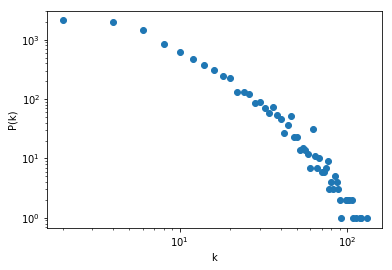

In [64]:
plt.scatter(hep_th_k[0], hep_th_k[1])
plt.xlabel('k')
plt.ylabel('P(k)')
plt.xscale('log')
plt.yscale('log')
plt.show()

Scale-free!

#### Average path length

In [65]:
hep_th.is_connected()

False

Let us focus on the largest connected components:

In [66]:
hep_th_cc_dim=np.array([len(i) for i in hep_th.components()])
np.where(hep_th_cc_dim==np.max(hep_th_cc_dim))

(array([0]),)

Actually **np.sort** <ins>creates a copy</ins> of the original vector ordered in ascending order... So let's use a trick!

In [67]:
-np.sort(-hep_th_cc_dim)

array([8638,   21,   11,    9,    9,    8,    8,    8,    8,    8,    8,
          7,    7,    7,    7,    7,    7,    7,    7,    7,    7,    7,
          6,    6,    6,    6,    6,    6,    6,    6,    5,    5,    5,
          5,    5,    5,    5,    5,    5,    5,    5,    5,    5,    5,
          5,    5,    5,    5,    5,    5,    5,    4,    4,    4,    4,
          4,    4,    4,    4,    4,    4,    4,    4,    4,    4,    4,
          4,    4,    4,    4,    4,    4,    4,    4,    4,    4,    4,
          4,    4,    4,    4,    4,    4,    4,    4,    4,    4,    4,
          4,    4,    4,    4,    4,    4,    4,    4,    3,    3,    3,
          3,    3,    3,    3,    3,    3,    3,    3,    3,    3,    3,
          3,    3,    3,    3,    3,    3,    3,    3,    3,    3,    3,
          3,    3,    3,    3,    3,    3,    3,    3,    3,    3,    3,
          3,    3,    3,    3,    3,    3,    3,    3,    3,    3,    3,
          3,    3,    3,    3,    3,    3,    3,   

Actually the biggest component is indeed big.

In [68]:
vertex_cc=hep_th.components()[0]
hep_th_lcc=hep_th.subgraph(vertex_cc)

In [69]:
len(hep_th_lcc.vs)

8638

In [70]:
len(hep_th_lcc.vs)/len(hep_th.vs)

0.8745570517363572

In [71]:
hep_th_lcc.average_path_length()

5.945432380163172

In [72]:
hep_th.average_path_length()

5.945216464793838

In [73]:
%timeit hep_th_lcc.average_path_length()

5.52 s ± 20.6 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [74]:
%timeit hep_th.average_path_length()

5.6 s ± 3.47 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


Not that different... why so?  
[Check the documentation!](https://igraph.org/python/doc/igraph.GraphBase-class.html#average_path_length)
> unconn - what to do when the graph is unconnected. If True, the average of the geodesic lengths in the components is calculated. Otherwise for all unconnected vertex pairs, a path length equal to the number of vertices is used.

#### Clustering coefficient

For some odd reason, the clustering coefficient has a strange name on igraph.

In [161]:
hep_th.transitivity_avglocal_undirected()

0.5995884015135738

In [162]:
%timeit hep_th.transitivity_avglocal_undirected()

9.82 ms ± 82.7 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


## Regular graph !!! TO BE CHECKED!!!

In a regular lattice all nodes have the same degree. Let us build a regular lattice and check which are their properties, in terms of degree distribution, clustering coefficient and average path length. 

### Exercise
Build a regular lattice with the same number of nodes and the same number of links and calculate the quantities examined so far. 

In [15]:
average_degree_int=len(data)//len(vertices)

In [16]:
average_degree_int

5

In [20]:
rl=ig.Graph.K_Regular(len(vertices), average_degree_int)

InternalError: Error at /project/vendor/source/igraph/src/games.c:946: No simple undirected graph can realize the given degree sequence, Invalid value

Ouch! Is there a check?

In [21]:
ig._igraph.is_graphical_degree_sequence(average_degree_int*np.ones(len(vertices)))

False

In [22]:
ig._igraph.is_graphical_degree_sequence(1+average_degree_int*np.ones(len(vertices)))

True

In [24]:
rl_more=ig.Graph.K_Regular(len(vertices), average_degree_int+1)
rl_less=ig.Graph.K_Regular(len(vertices), average_degree_int-1)

#### Degree sequence
Ok, that's trivial!

In [132]:
rl_less.degree()

[4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,
 4,


#### Average path length

In [25]:
rl_more.average_path_length()

5.601302911186287

In [26]:
rl_less.average_path_length()

7.714013430402538

#### Clustering coefficient

In [28]:
rl_more.transitivity_avglocal_undirected()

0.000647970031386048

In [27]:
rl_less.transitivity_avglocal_undirected()

0.00020249063480814013

### Plot

In [38]:
layout=rl_less.layout_auto()

In [39]:
vertex_size=np.array(rl_less.vs.degree())/10

In [40]:
ig.plot(rl_less, '../Images/regular_lattice.png', layout=layout, vertex_size=vertex_size, edge_width=.3, vertex_color='blue', vertex_frame_color='blue', edge_curved=.75)

### networkx

In [196]:
lv

9877

In [238]:
cacca=nx.random_regular_graph(4, 6)

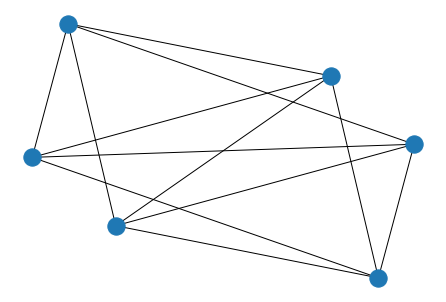

In [239]:
nx.draw_kamada_kawai(cacca)

In [274]:
cacca=nx.circulant_graph(10, [1,2,3])

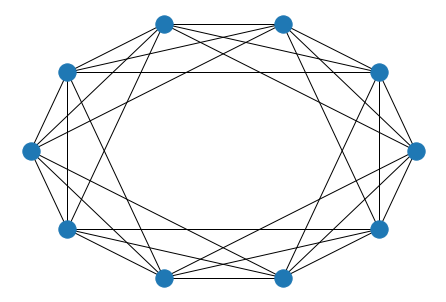

In [296]:
nx.draw_kamada_kawai(cacca)

In [276]:
regular=nx.random_regular_graph(5, lv)

NetworkXError: n * d must be even

In [277]:
regular=nx.random_regular_graph(6, lv)

In [278]:
circular=nx.circulant_graph(lv, [1,2,3])

In [242]:
regular.number_of_nodes()

9877

In [279]:
circular.number_of_nodes()

9877

In [243]:
regular.number_of_edges()

29631

In [280]:
circular.number_of_edges()

29631

In [249]:
hep_th_nx.number_of_edges()

25998

In [ ]:
nx.draw(regular, node_size=20)

In [281]:
nx.draw(circular, node_size=20)

KeyboardInterrupt: 

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x7efc82cc58c8> (for post_execute):


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7efc82cd21e0> (for post_execute):


KeyboardInterrupt: 

#### Degree sequence

In [250]:
reg_k=np.array(regular.degree())

In [251]:
np.unique(reg_k[:, 1])

array([6])

In [282]:
cir_k=np.array(circular.degree())

In [283]:
np.unique(cir_k[:, 1])

array([6])

#### Clustering coefficient

In [252]:
nx.average_clustering(regular)

0.0004049812696162808

In [284]:
nx.average_clustering(circular)

0.600000000000068

## Erdos-Renyi sampling

### Exercise
Sample the Erdos-Renyi ensemble and calculate the same quantities of the previous exercise and example.

Actually in this case too, igraph can help us, creating an instance from the ensemble either a la Erdos-Renyi or a la Solomonoff.

In [44]:
er_pure=ig.Graph.Erdos_Renyi(n=lv, m=le)
er_solomonoff=ig.Graph.Erdos_Renyi(n=lv, p=le/lv/(lv-1))

### Since we are creating an ensemble, the calculation is a little subtler...
Let's create a sample of 1000 instances.

#### Average Path Length

In [45]:
er_pure_apl=np.zeros(1000)
er_solo_apl=np.zeros(1000)

In [75]:
%timeit er_pure.average_path_length()

7.19 s ± 58.7 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [76]:
%timeit er_solo.average_path_length()

6.32 s ± 4.46 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


Is it a good idea?

In [47]:
for i in notebook.tqdm(range(1000)):
    er_pure=ig.Graph.Erdos_Renyi(n=lv, m=le)
    er_solo=ig.Graph.Erdos_Renyi(n=lv, p=le/lv/(lv-1))
    er_pure_apl[i]=er_pure.average_path_length()
    er_solo_apl[i]=er_solo.average_path_length()

KeyboardInterrupt: 

#### Clustering coefficient

In [77]:
%timeit er_pure.transitivity_avglocal_undirected()

7.97 ms ± 4.46 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [78]:
%timeit er_solo.transitivity_avglocal_undirected()

4.21 ms ± 4.58 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [80]:
er_pure_cc=np.zeros(1000)
er_solo_cc=np.zeros(1000)

In [81]:
for i in notebook.tqdm(range(1000)):
    er_pure=ig.Graph.Erdos_Renyi(n=lv, m=le)
    er_solo=ig.Graph.Erdos_Renyi(n=lv, p=le/lv/(lv-1))
    er_pure_cc[i]=er_pure.transitivity_avglocal_undirected()
    er_solo_cc[i]=er_solo.transitivity_avglocal_undirected()

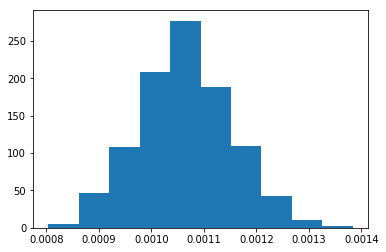

In [82]:
plt.hist(er_pure_cc)
plt.show()

## Implement your own Erdos-Renyi (a la Solomonoff)

Actually there is a numpy submodule generating random numbers, that is call (surprise surprise) random

In [29]:
from numpy import random

In [30]:
max_link_number=int(len(vertices)*(len(vertices)-1)/2)

In [31]:
max_link_number

48772626

The Erdos-Renyi probability

In [32]:
p_er=len(data)/max_link_number

In [33]:
p_er

0.001065577235886376

In [34]:
er_mask=random.rand(max_link_number)<p_er

In [35]:
edge_list_er=[]
v_counter=0

for v in notebook.tqdm(range(lv-1)):
    for w in range(v+1, lv):
        if random.rand()<p_er:
            edge_list_er.append((v, w))
        v_counter+=1

NameError: name 'lv' is not defined

In [36]:
edge_list_er=[]
v_counter=0

for v in notebook.tqdm(range(lv-1)):
    for w in range(v+1, lv):
        if er_mask[v_counter]:
            edge_list_er.append((v, w))
        v_counter+=1

NameError: name 'lv' is not defined

In [123]:
def mask_vec():
    edge_list_er=[]
    v_counter=0

    for v in range(lv-1):
        for w in range(v+1, lv):
            if er_mask[v_counter]:
                edge_list_er.append((v, w))
            v_counter+=1

In [124]:
def random_vec():
    edge_list_er=[]
    v_counter=0

    for v in range(lv-1):
        for w in range(v+1, lv):
            if random.rand()<p_er:
                edge_list_er.append((v, w))
            v_counter+=1

In [125]:
%timeit mask_vec()

6.47 s ± 1.49 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [126]:
%timeit random_vec()

23.7 s ± 39.6 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [105]:
l_sample=1000

In [130]:
clustering_er=np.zeros(l_sample)

for s in notebook.tqdm(range(l_sample)):
    counter=0
    s_er=ig.Graph()
    s_er.add_vertices(lv)
    er_mask=random.rand(max_link_number)<p_er
    for v in notebook.tqdm(range(lv-1), leave=False):
        for w in range(v+1, lv):
            if er_mask[counter]:
                s_er.add_edge(v, w)
            counter+=1
    clustering_er[s]=s_er.transitivity_avglocal_undirected()

KeyboardInterrupt: 

### networkx

#### Degree distribution

In [188]:
    counter=0
    s_er=nx.Graph()
    er_mask=random.rand(max_link_number)<p_er
    for v in notebook.tqdm(range(lv-1)):
        for w in range(v+1, lv):
            if er_mask[counter]:
                s_er.add_edge(v, w)
            counter+=1

In [189]:
s_er_k=np.array(s_er.degree())

In [190]:
s_er_kk=np.unique(s_er_k[:,1], return_counts=True)

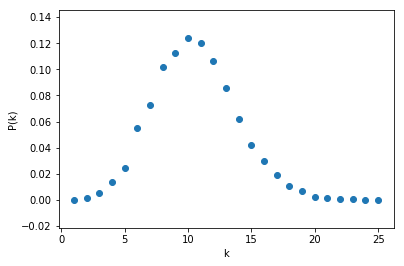

In [191]:
plt.scatter(s_er_kk[0], s_er_kk[1]/np.sum(s_er_kk[1]))
plt.xlabel('k')
plt.ylabel('P(k)')
#plt.xscale('log')
#plt.yscale('log')
plt.show()

#### Clustering coefficient

In [27]:
l_sample=100

In [40]:
clustering_er=np.zeros(l_sample)

for s in notebook.tqdm(range(l_sample)):
    counter=0
    s_er=nx.Graph()
    er_mask=random.rand(max_link_number)<p_er
    for v in notebook.tqdm(range(lv-1), leave=False):
        for w in range(v+1, lv):
            if er_mask[counter]:
                s_er.add_edge(v, w)
            counter+=1
    clustering_er[s]=nx.average_clustering(s_er)

In [41]:
clustering_er

array([0.00103365, 0.00098348, 0.00101647, 0.00120192, 0.00103786,
       0.0011026 , 0.00109692, 0.00125238, 0.00099497, 0.00099501,
       0.00100223, 0.0010913 , 0.0013727 , 0.0009736 , 0.00105614,
       0.00105072, 0.00110121, 0.00117617, 0.0011169 , 0.00115401,
       0.00103188, 0.0011482 , 0.00109268, 0.00101289, 0.00099541,
       0.00095799, 0.00114823, 0.00105394, 0.00108493, 0.0009119 ,
       0.000898  , 0.00108254, 0.00110424, 0.00127174, 0.00100841,
       0.00114176, 0.00099486, 0.00111565, 0.00104013, 0.00115954,
       0.00118513, 0.00093929, 0.0010381 , 0.00103177, 0.00102492,
       0.00112379, 0.00108417, 0.00121024, 0.00111468, 0.00110733,
       0.00095808, 0.00114555, 0.00108494, 0.00101299, 0.00121609,
       0.00109282, 0.00096305, 0.00101052, 0.00093549, 0.00094677,
       0.00091952, 0.0009321 , 0.00115669, 0.00095958, 0.00111206,
       0.00107258, 0.00106589, 0.00116166, 0.00103086, 0.00106427,
       0.00101132, 0.00109136, 0.00105914, 0.00103028, 0.00092

In [42]:
np.average(clustering_er)

0.0010653106993572328

In [43]:
np.std(clustering_er)

8.83866595866386e-05

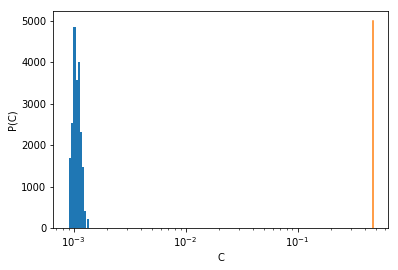

In [57]:
plt.hist(clustering_er, density=1)
plt.plot([hep_th_clust, hep_th_clust],[0, 5000])
plt.xlabel('C')
plt.ylabel('P(C)')
plt.xscale('log')
plt.show()

## Watts-Strogatz (small world)

In [288]:
ws_0=circular.copy()

In [291]:
list(ws_0.edges())

[(0, 1),
 (0, 2),
 (0, 3),
 (0, 9875),
 (0, 9876),
 (0, 9874),
 (1, 2),
 (1, 3),
 (1, 4),
 (1, 9876),
 (1, 9875),
 (2, 3),
 (2, 9876),
 (2, 5),
 (2, 4),
 (3, 4),
 (3, 5),
 (3, 6),
 (4, 5),
 (4, 6),
 (4, 7),
 (5, 6),
 (5, 7),
 (5, 8),
 (6, 7),
 (6, 8),
 (6, 9),
 (7, 8),
 (7, 9),
 (7, 10),
 (8, 9),
 (8, 10),
 (8, 11),
 (9, 10),
 (9, 11),
 (9, 12),
 (10, 11),
 (10, 12),
 (10, 13),
 (11, 12),
 (11, 13),
 (11, 14),
 (12, 13),
 (12, 14),
 (12, 15),
 (13, 16),
 (13, 14),
 (13, 15),
 (14, 16),
 (14, 17),
 (14, 15),
 (15, 16),
 (15, 17),
 (15, 18),
 (16, 17),
 (16, 18),
 (16, 19),
 (17, 18),
 (17, 19),
 (17, 20),
 (18, 19),
 (18, 20),
 (18, 21),
 (19, 20),
 (19, 21),
 (19, 22),
 (20, 21),
 (20, 22),
 (20, 23),
 (21, 22),
 (21, 23),
 (21, 24),
 (22, 23),
 (22, 24),
 (22, 25),
 (23, 24),
 (23, 25),
 (23, 26),
 (24, 25),
 (24, 26),
 (24, 27),
 (25, 26),
 (25, 27),
 (25, 28),
 (26, 27),
 (26, 28),
 (26, 29),
 (27, 28),
 (27, 29),
 (27, 30),
 (28, 29),
 (28, 30),
 (28, 31),
 (29, 32),
 (29, 30),
 (2

In [294]:
list(ws_0[0])

[1, 2, 3, 9875, 9876, 9874]

In [ ]:
ws_0.number_of_nodes

In [305]:
ws_0=nx.circulant_graph(10, range(1, 1+int(7/2)))

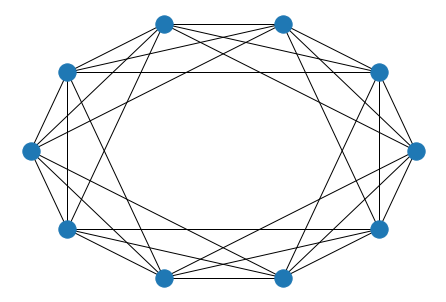

In [306]:
nx.draw_kamada_kawai(ws_0)

In [307]:
np.sort([4,3,1,2])

array([1, 2, 3, 4])

In [354]:
def ws_graph(p, ln, k):
    ws_0=nx.circulant_graph(ln, range(1, 1+int(k/2)))
    le=ws_0.number_of_edges()
    ws_mask=np.random.random(2*le)<p
    
    counter=0
    for i in notebook.tqdm(range(ln)):
        neigh=np.sort(ws_0[i])
        for j in neigh:
            if ws_mask[counter]:
                
                ws_0.remove_edge(i,j)
                
                new_j=np.random.choice(ln)
                while new_j in np.sort(ws_0[i]):
                    new_j=np.random.choice(ln)
                ws_0.add_edge(i, new_j)
                
            counter+=1
    return ws_0

In [366]:
cacca=ws_graph(0.5, 10, 6)

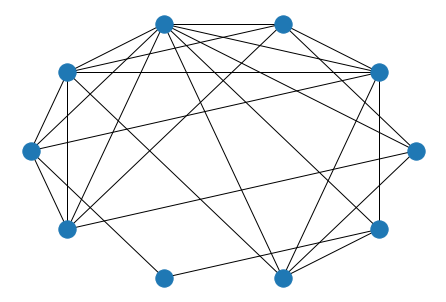

In [381]:
nx.draw_circular(cacca)

In [346]:
cacca.number_of_edges()

30

In [357]:
benchmark=nx.circulant_graph(10, range(1, 4))

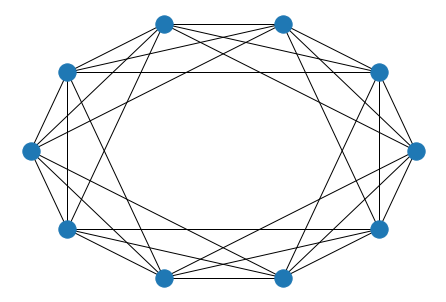

In [358]:
nx.draw_circular(benchmark)

In [359]:
benchmark.number_of_edges()

30

#### Actually...
there is even the networkx function...

In [368]:
le/lv

5.261820390806925

In [81]:
ws_vec=[nx.connected_watts_strogatz_graph(500, 4, p=10**-p) for p in range(5)]

In [387]:
ws_vec=[nx.connected_watts_strogatz_graph(lv, int(le/lv), p=p) for p in [0, 0.2, 0.4, 0.6, 0.8, 1]]

In [84]:
ws_vec_ac=[nx.average_clustering(ws) for ws in ws_vec]

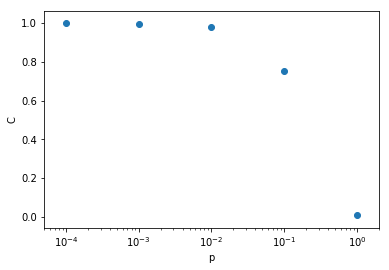

In [91]:
plt.scatter([10**-p for p in range(5)], np.array(ws_vec_ac)/ws_vec_ac[-1])
plt.xlabel('p')
plt.ylabel('C')
plt.xscale('log')
plt.xlim(5*10**-5, 2)
plt.show()

In [88]:
ws_vec_aspl=[nx.average_shortest_path_length(ws) for ws in ws_vec]

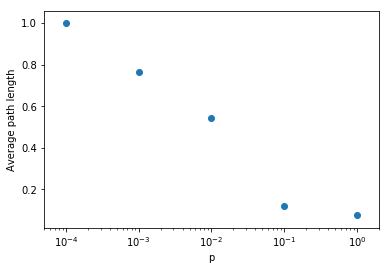

In [90]:
plt.scatter([10**-p for p in range(5)], np.array(ws_vec_aspl)/ws_vec_aspl[-1])
plt.xlabel('p')
plt.ylabel('Average path length')
plt.xscale('log')
plt.xlim(5*10**-5, 2)
plt.show()

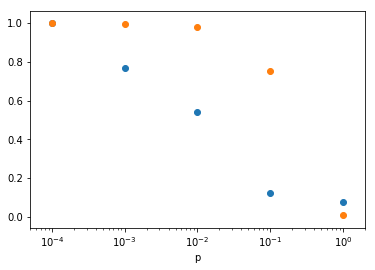

In [92]:
plt.scatter([10**-p for p in range(5)], np.array(ws_vec_aspl)/ws_vec_aspl[-1], label='Average path length')
plt.scatter([10**-p for p in range(5)], np.array(ws_vec_ac)/ws_vec_ac[-1], label='Clustering')
plt.xlabel('p')
plt.xscale('log')
plt.xlim(5*10**-5, 2)
plt.show()

### Degree sequence

In [377]:
ws_vec_k=np.array(ws_vec[3].degree())

In [379]:
ws_vec_kk=np.unique(ws_vec_k[:,1], return_counts=True)

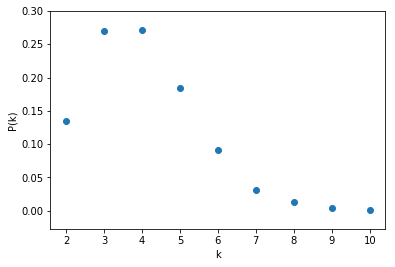

In [380]:
plt.scatter(ws_vec_kk[0], ws_vec_kk[1]/np.sum(ws_vec_kk[1]))
plt.xlabel('k')
plt.ylabel('P(k)')
#plt.xscale('log')
#plt.yscale('log')
plt.show()

In [422]:
titles=['p='+str(float(p)) for p in [0, 0.2, 0.4, 0.6, 0.8, 1]]

In [423]:
titles

['p=0.0', 'p=0.2', 'p=0.4', 'p=0.6', 'p=0.8', 'p=1.0']

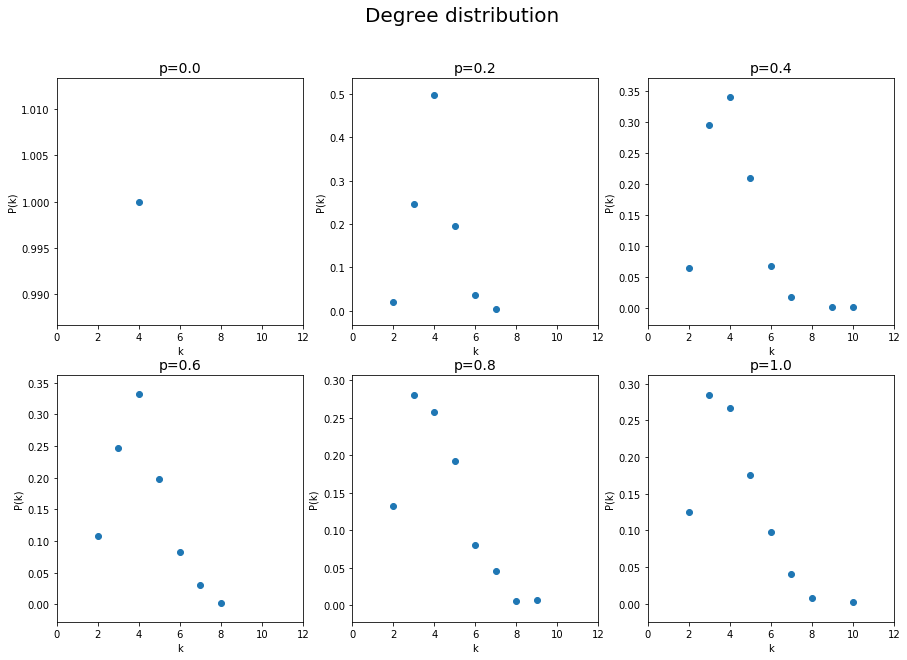

In [426]:
fig, ax_lst = plt.subplots(2, 3, figsize=(15,10))
fig.suptitle('Degree distribution', fontsize=20)

for t in enumerate(titles):
    y=t[0]%3
    x=t[0]//3
    ax_lst[x,y].set_title(t[1], fontsize=14)
    
    ws_vec_k=np.array(ws_vec[t[0]].degree())
    ws_vec_kk=np.unique(ws_vec_k[:,1], return_counts=True)
    
    ax_lst[x,y].scatter(ws_vec_kk[0], ws_vec_kk[1]/np.sum(ws_vec_kk[1]))
    ax_lst[x,y].set_xlabel('k')
    ax_lst[x,y].set_ylabel('P(k)')
    ax_lst[x,y].set_xlim(0, 12)
    
    
plt.show()

## Barabasi-Albert

### How to plot with igraph (optional, i.e. !!!!DON'T DO IT DURING THE CLASS!!!!, otherwise we blast the server)

Actually plotting is not as nice as networkx (since networkx can be controlled in a matplotlib way), but in relative small amount of time (say, minutes) it is able to plot bigger plots, as the one we have.

In [66]:
layout=hep_th.layout_auto()

In [60]:
vertex_size=np.array(hep_th.vs.degree())/10

In [70]:
ig.plot(hep_th, '../Images/hep_th_net.png', layout=layout, vertex_size=vertex_size, edge_width=.3, vertex_color='blue', vertex_frame_color='blue', edge_curved=.75)